In [1]:
import os
from glob import glob
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from monai.transforms import (
    EnsureChannelFirstd,
    EnsureTyped,
    Compose,
    CropForegroundd,
    Resized,
    LoadImaged,
    RandCropByPosNegLabeld,
    Orientationd,
    RandGaussianNoised,
    ScaleIntensityRanged,
    Spacingd,
    RandRotated,
    ToTensord,
    RandAffined,
)
from monai.data import Dataset
from monai.utils import first

from torch.utils.data import DataLoader

## <span style="color:red">Note</span>

Download data from [drive](https://drive.google.com/file/d/1yU_MeDoMHnLg0vNAy4Hb7_liJBogWl_N/view?usp=share_link) link and save the data in `/data` folder.

Folder Structure

```txt
├── data
    ├── imageTr        
    ├── labelsTR     
    └── test      
```

In [2]:
ROOT_FOLDER=r"data"
IMAGE_FOLDER=r"imagesTr"
LABLE_FOLDER=r"labelsTr"

In [3]:
image_path = sorted(glob(os.path.join(ROOT_FOLDER, IMAGE_FOLDER, "*.nii.gz")))
lable_path = sorted(glob(os.path.join(ROOT_FOLDER, LABLE_FOLDER, "*.nii.gz")))

In [4]:
data_path = [{"image": image_name, "label": lable_name} for image_name, lable_name in zip(image_path, lable_path)]

In [14]:
data_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"]),
        EnsureChannelFirstd(keys=["image", "label"]),
        EnsureTyped(keys=["image", "label"]),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 2.0),
            mode=("bilinear", "nearest"),
        ),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        ScaleIntensityRanged(
            keys=["image"],
            a_min=-200,
            a_max=200,
            b_min=0.0,
            b_max=1.0,
            clip=True,
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        RandCropByPosNegLabeld(
            keys=["image", "label"],
            label_key="label",
            spatial_size=(96, 96, 96),
            pos=3,
            neg=1,
            num_samples=4,
            image_key="image",
            image_threshold=0,
        ),
        RandAffined(keys=['image', 'label'], prob=0.5, translate_range=10), 
        RandRotated(keys=['image', 'label'], prob=0.5, range_x=10.0),
        RandGaussianNoised(keys='image', prob=0.5),
        ToTensord(keys=["image", "label"]),
    ]
)

In [15]:
dataset=Dataset(data_path, data_transforms)
loader=DataLoader(dataset)

In [16]:
for batch in loader:
    print(len(batch), type(batch), batch[0])
    break

4 <class 'list'> {'image': tensor([[[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           ...,
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

          [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           ...,
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

          [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],

In [10]:
preprocessed_img=first(loader)

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


over
over
over
over


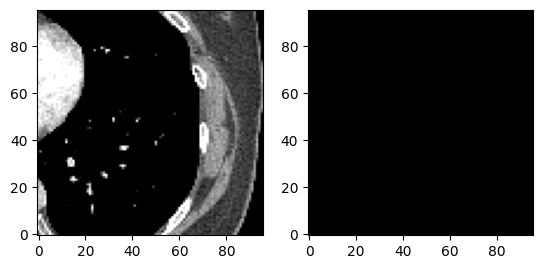

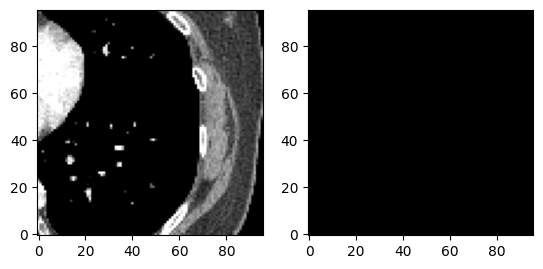

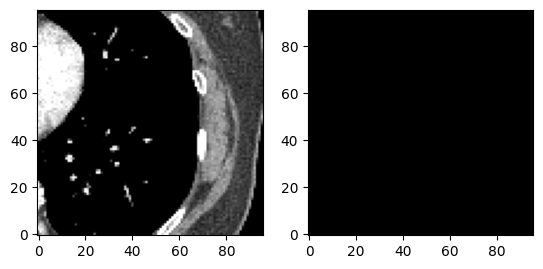

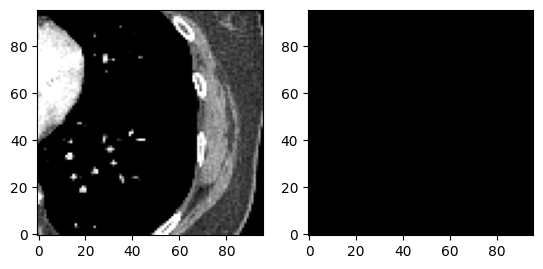

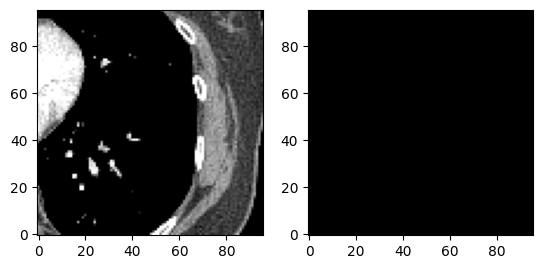

...

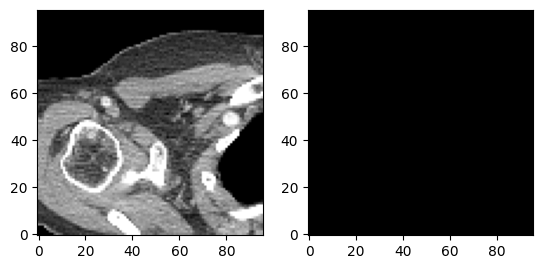

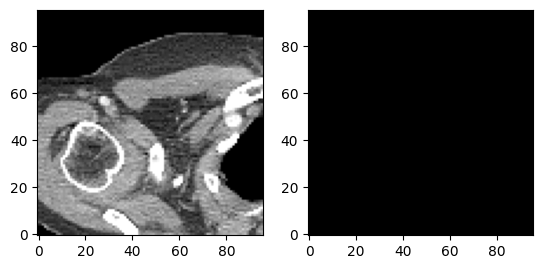

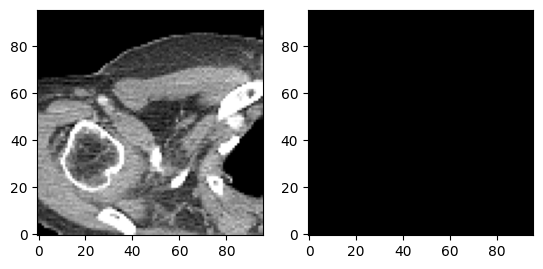

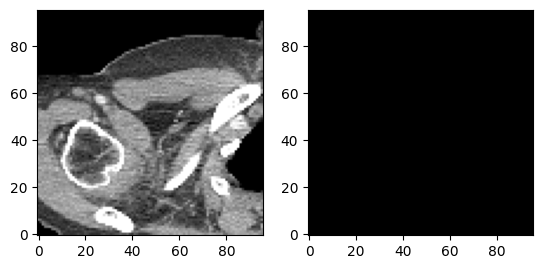

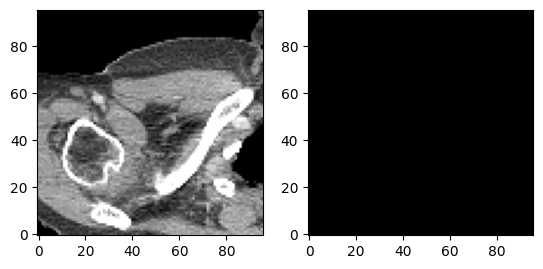

In [11]:
for patch in preprocessed_img:
    image=patch['image'][0, 0, :, :, :]
    label=patch['label'][0, 0, :, :, :]
    
    for i in range(image.shape[0]):
        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(image[:, :, i].T, cmap="gray", origin="lower")
        axes[1].imshow(label[:, :, i].T, cmap="gray", origin="lower")
        fig.show()
    print("over")

In [7]:
def show_mid_slice(img, title='img'):
    n_i, n_j, n_k = img.shape
    
    # sagittal (left image)
    center_i1 = int((n_i - 1) / 2)
    # coronal (center image)
    center_j1 = int((n_j - 1) / 2)
    # axial slice (right image)
    center_k1 = int((n_k - 1) / 2)
    
    img_lst=[img[center_i1, :, :],
             img[:, center_j1, :],
             img[:, :, center_k1]]
    
    show_slices(img_lst)
    plt.suptitle(title)

def show_slices(img_slices):
    fig, axes = plt.subplots(1, 3)
    
    for i, slice in enumerate(img_slices):
        axes[i].imshow(slice.T, cmap="gray", origin="lower")

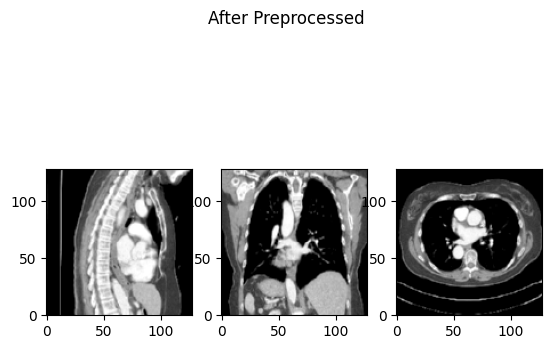

In [23]:
show_mid_slice(image, "After Preprocessed")

In [11]:
path=os.path.join(ROOT_FOLDER, IMAGE_FOLDER, "lung_001.nii.gz")
numpy_3D_medical_volume = nib.load(path).get_fdata(dtype=np.float32)

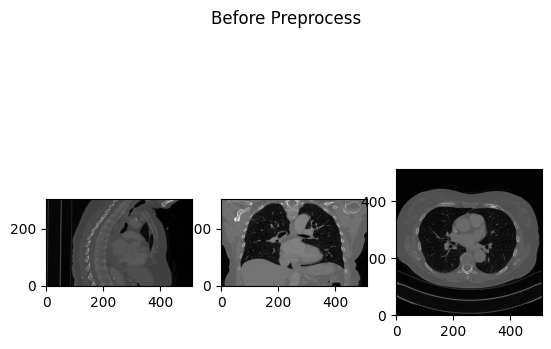

In [12]:
show_mid_slice(numpy_3D_medical_volume, "Before Preprocess")